In [2]:
from pathlib import Path
import os
import json

from omegaconf import OmegaConf

from pipeline_functions import plot_predictions, _convert_format
CFG = OmegaConf.load("config_luke.yaml")

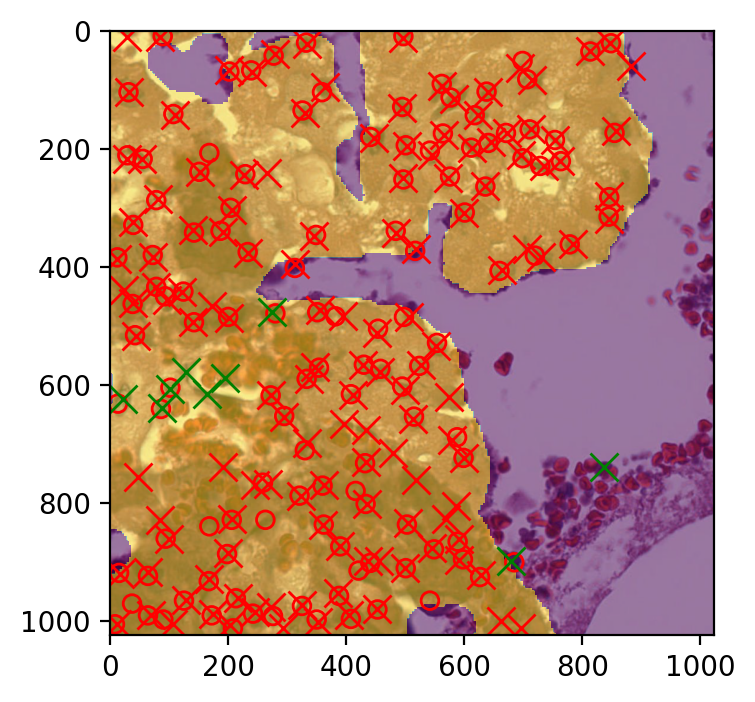

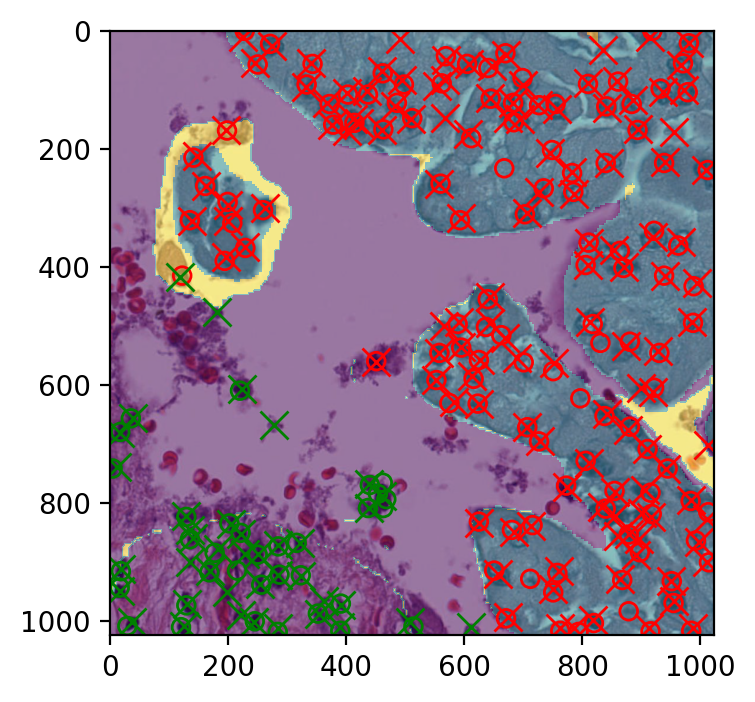

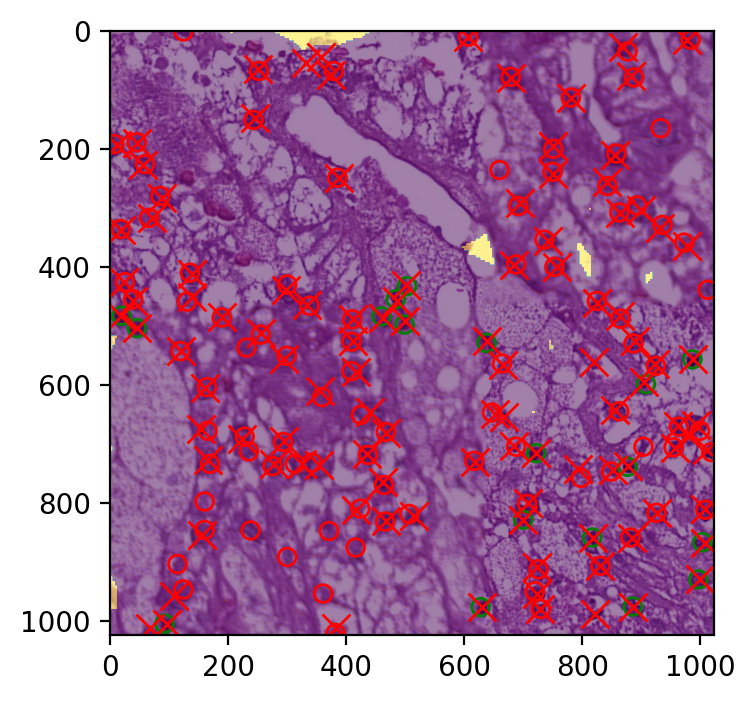

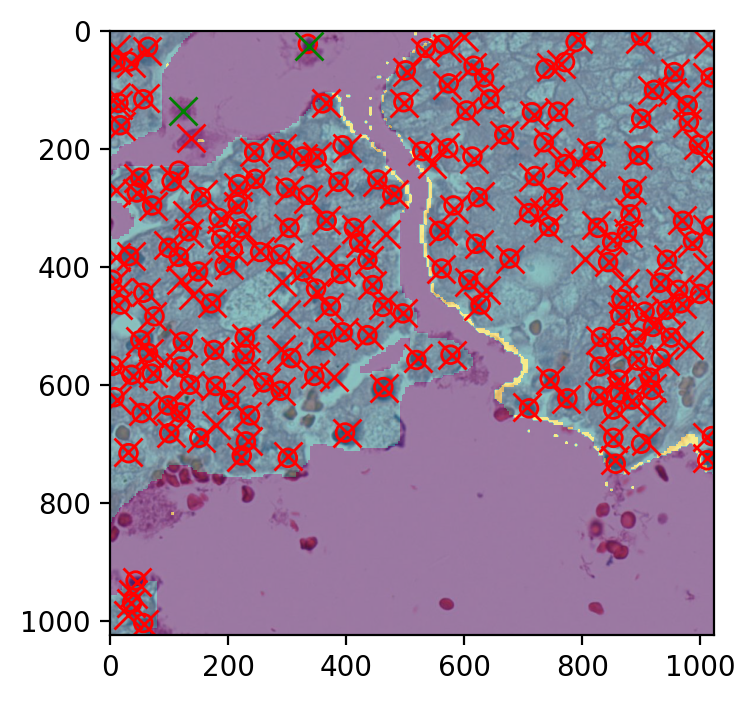

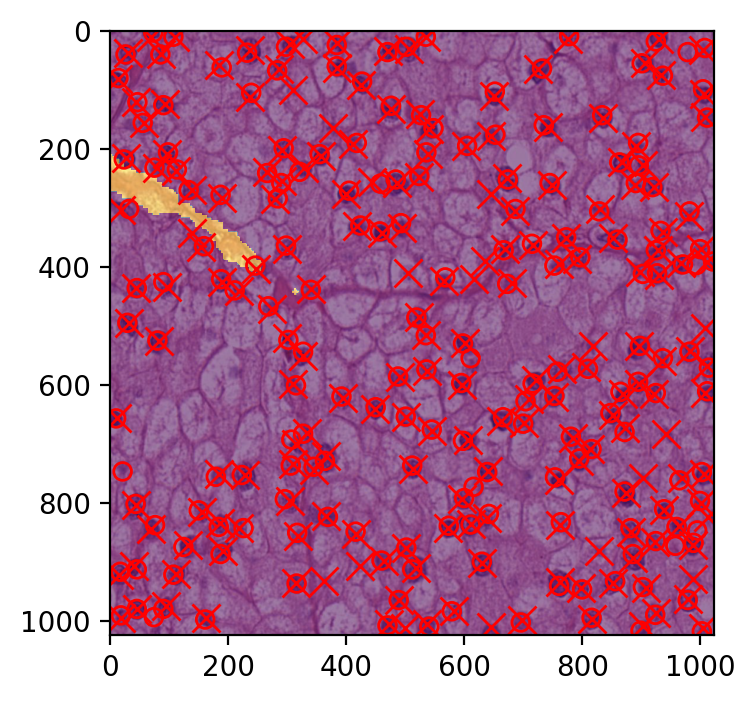

...

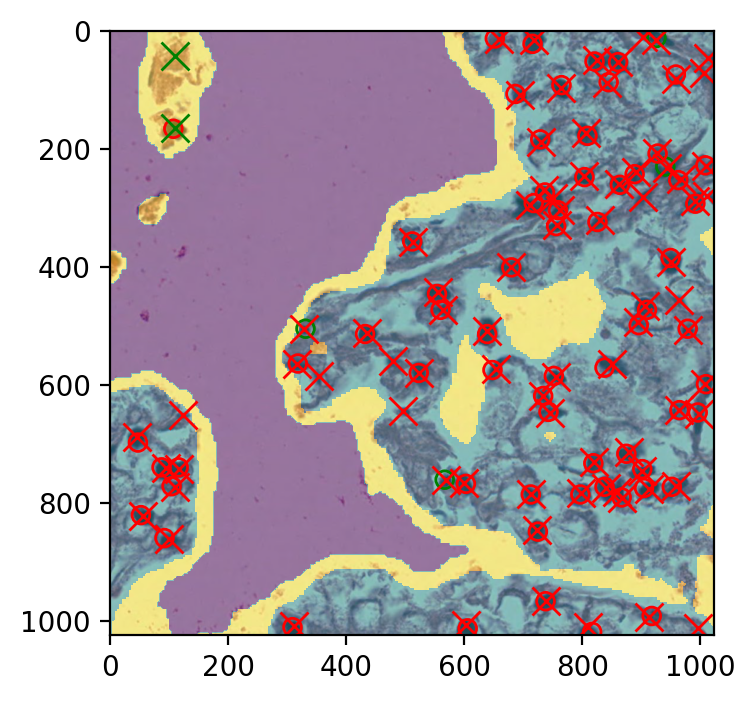

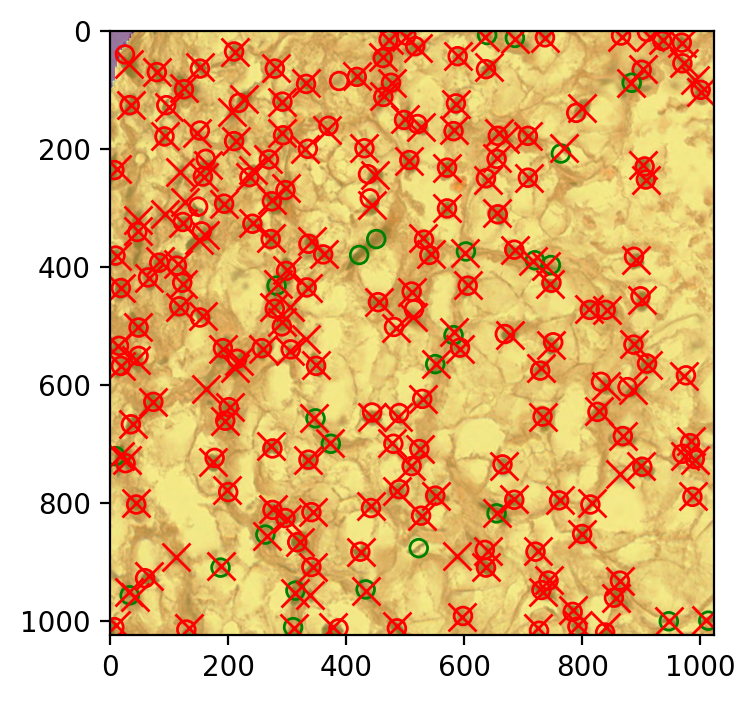

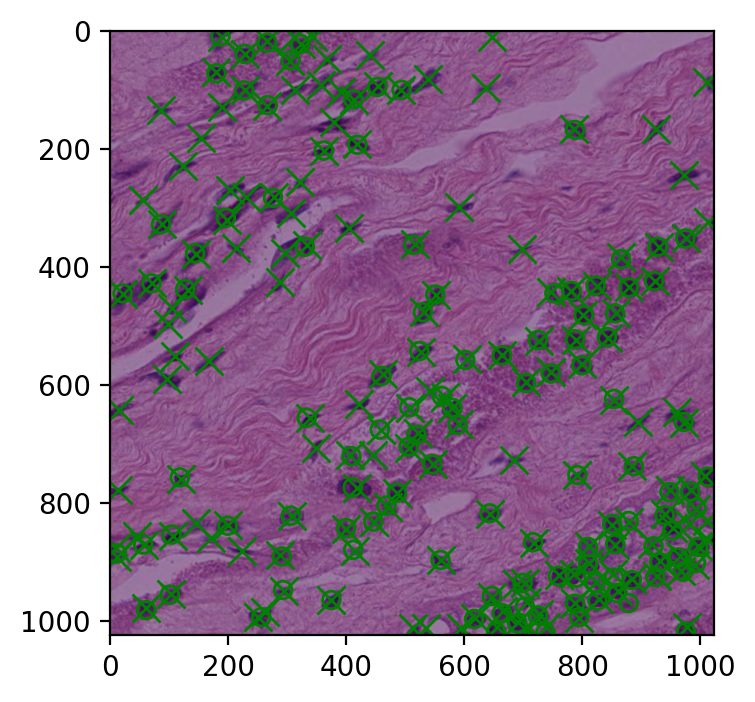

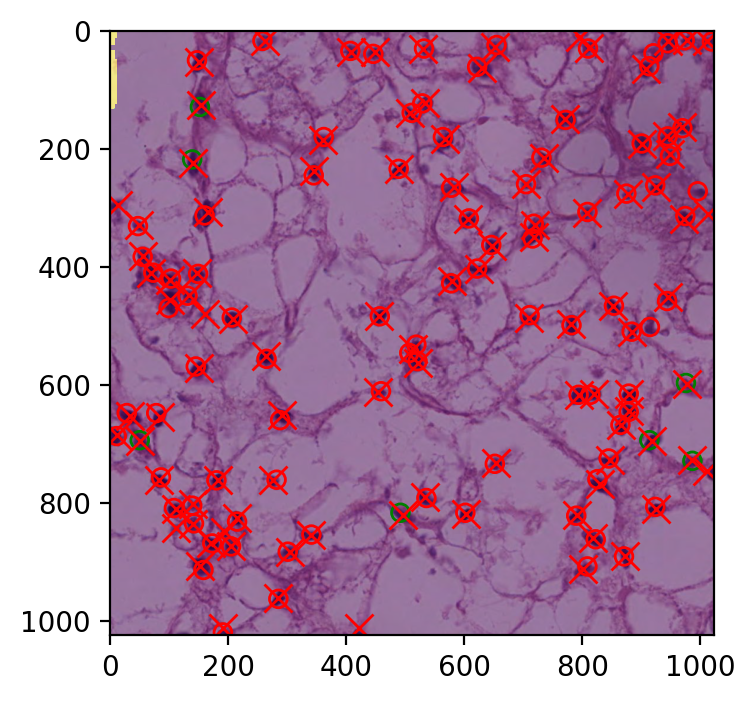

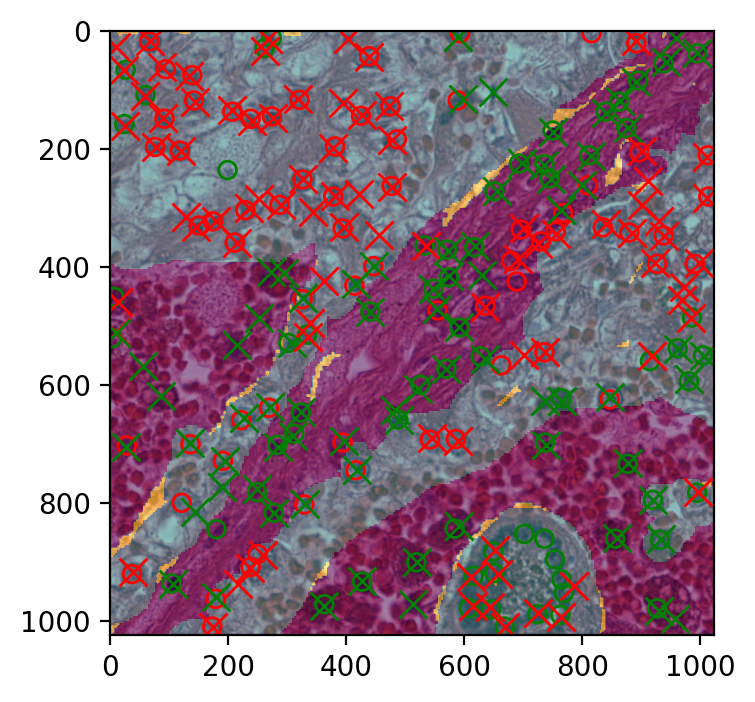

In [3]:
# Path to the folders containing the images and metadata
CELL_FPATH = Path(os.path.join(CFG.directory, 'datasets\\valid\\images'))
TISSUE_FPATH = Path(os.path.join(CFG.directory, 'datasets\\valid\\tissue_images'))
METADATA_FPATH = Path(os.path.join(CFG.directory, 'datasets\\metadata.json'))
GROUND_TRUTH_LABELS = Path(os.path.join(CFG.directory, 'datasets\\valid\\labels\\cell_ground_truth_valid.json'))
GROUND_TRUTH_SEGMENTATIONS = Path(os.path.join(CFG.directory, 'datasets\\valid\\labels\\segmentations'))
DETECTION_OUTPUT_PATH = Path(os.path.join(CFG.directory, 'test\\prediction.json'))

# Path where algorithm output is stored
with open(DETECTION_OUTPUT_PATH, "r") as f:
    pred_json = json.load(f)["points"]

# Path where GT is stored
with open(GROUND_TRUTH_LABELS, "r") as f:
    gt_json = json.load(f)["points"]


# Convert the format of GT and pred for easy score computation
pred_all, gt_all = _convert_format(pred_json=pred_json, gt_json=gt_json, num_images=40)

filenames_seg = [file for file in os.listdir(GROUND_TRUTH_SEGMENTATIONS) if file.endswith(".png")]

# Loop over the files in the image directory
for i, filename in enumerate(os.listdir(CELL_FPATH)):
    # Check if the file is an image file
    if filename.endswith('.jpg'):
        # Construct the paths to the image, annotations, and predictions files
        image_path = os.path.join(CELL_FPATH, filename)
        segmentation_path = os.path.join(GROUND_TRUTH_SEGMENTATIONS, filenames_seg[i])
        # Call the plot_predictions function with the image and annotations paths, and the predictions path
        plot_predictions(image_path,segmentation_path, gt_all[i], pred_all[i], filename, METADATA_FPATH)

    else:
        print(f'Error: annotations file not found for {filename}')